# Merged Tree x Heat Index x Rent Burden

In [8]:
import pandas as pd

#### Import and clean tree data

In [9]:
tree_df = pd.read_csv('data1/tracts_tree_class.csv')
tree_df.head()

,Fips,geometry,City,Tree Canopy Existing Percentage,Tree Canopy Class
0,6037137504,"POLYGON ((-118.581186 34.143176, -118.580994 3...",Woodland Hills,30.562925,3
1,6037138000,"POLYGON ((-118.60573 34.145854, -118.605611 34...",Woodland Hills,34.899442,3
2,6037138000,"POLYGON ((-118.60573 34.145854, -118.605611 34...",Woodland Hills,33.835898,3
3,6037138000,"POLYGON ((-118.60573 34.145854, -118.605611 34...",Woodland Hills,28.695348,3
4,6037139200,"POLYGON ((-118.530824 34.180236, -118.529515 3...",Encino,22.877822,2


In [10]:
tree_df = tree_df.rename(columns={'Fips': 'GEOID'})
tree_df.head()

,GEOID,geometry,City,Tree Canopy Existing Percentage,Tree Canopy Class
0,6037137504,"POLYGON ((-118.581186 34.143176, -118.580994 3...",Woodland Hills,30.562925,3
1,6037138000,"POLYGON ((-118.60573 34.145854, -118.605611 34...",Woodland Hills,34.899442,3
2,6037138000,"POLYGON ((-118.60573 34.145854, -118.605611 34...",Woodland Hills,33.835898,3
3,6037138000,"POLYGON ((-118.60573 34.145854, -118.605611 34...",Woodland Hills,28.695348,3
4,6037139200,"POLYGON ((-118.530824 34.180236, -118.529515 3...",Encino,22.877822,2


In [11]:
columns_to_keep_tree = ['GEOID', 
                   'City', 'Tree Canopy Existing Percentage', 'Tree Canopy Class'
                   ]
#add it to a new dataframe
tree_df=tree_df[columns_to_keep_tree]
tree_df.head()

,GEOID,City,Tree Canopy Existing Percentage,Tree Canopy Class
0,6037137504,Woodland Hills,30.562925,3
1,6037138000,Woodland Hills,34.899442,3
2,6037138000,Woodland Hills,33.835898,3
3,6037138000,Woodland Hills,28.695348,3
4,6037139200,Encino,22.877822,2


In [12]:
tree_df.max()

GEOID                                  6037980033
City                               Woodland Hills
Tree Canopy Existing Percentage         73.651043
Tree Canopy Class                               4
dtype: object

#### Import and celan heat data

In [13]:
heat_df = pd.read_csv('data1/merged_tracts.csv')
heat_df.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,GEOIDFQ,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,HWAV_RISKS,heatrisk_class
0,6,37,599100,6037599100,1400000US06037599100,5991.00,Census Tract 5991,G5020,S,337352192,1098469235,32.925570,-118.497290,MULTIPOLYGON (((-13173947.320773387 3940389.95...,15.892118,0
1,6,37,620305,6037620305,1400000US06037620305,6203.05,Census Tract 6203.05,G5020,S,1265579,1275093,33.892367,-118.416573,POLYGON ((-13182420.365878586 4015434.46283120...,21.851068,0
2,6,37,620201,6037620201,1400000US06037620201,6202.01,Census Tract 6202.01,G5020,S,229583,183201,33.903370,-118.421856,POLYGON ((-13182717.926413272 4016079.72588719...,16.687675,0
3,6,37,620102,6037620102,1400000US06037620102,6201.02,Census Tract 6201.02,G5020,S,871913,0,33.920194,-118.418063,POLYGON ((-13183097.643692017 4018544.68730978...,20.628597,0
4,6,37,620101,6037620101,1400000US06037620101,6201.01,Census Tract 6201.01,G5020,S,1335926,3064,33.927450,-118.420861,POLYGON ((-13183392.533542898 4019531.97673561...,24.027256,1


In [14]:
columns_to_keep_heat = ['GEOID', 
                   'HWAV_RISKS', 'heatrisk_class', 'geometry'
                   ]
#add it to a new dataframe
heat_df=heat_df[columns_to_keep_heat]
heat_df.head()

,GEOID,HWAV_RISKS,heatrisk_class,geometry
0,6037599100,15.892118,0,MULTIPOLYGON (((-13173947.320773387 3940389.95...
1,6037620305,21.851068,0,POLYGON ((-13182420.365878586 4015434.46283120...
2,6037620201,16.687675,0,POLYGON ((-13182717.926413272 4016079.72588719...
3,6037620102,20.628597,0,POLYGON ((-13183097.643692017 4018544.68730978...
4,6037620101,24.027256,1,POLYGON ((-13183392.533542898 4019531.97673561...


In [15]:
heat_df.max()

GEOID                                                    6111009700
HWAV_RISKS                                                90.894497
heatrisk_class                                                    4
geometry          POLYGON ((-13240856.032008236 4034913.40381115...
dtype: object

#### Import and clean rent-burden data

In [16]:
Rb_df = pd.read_csv('data1/RentBurden_merged_tracts.csv')
Rb_df.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,GEOIDFQ,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,Pct_RentBurden,RentBurden_class
0,6,37,599100,6037599100,1400000US06037599100,5991.00,Census Tract 5991,G5020,S,337352192,1098469235,32.925570,-118.497290,MULTIPOLYGON (((-13173947.320773387 3940389.95...,50.94,2
1,6,37,620305,6037620305,1400000US06037620305,6203.05,Census Tract 6203.05,G5020,S,1265579,1275093,33.892367,-118.416573,POLYGON ((-13182420.365878586 4015434.46283120...,35.33,1
2,6,37,620201,6037620201,1400000US06037620201,6202.01,Census Tract 6202.01,G5020,S,229583,183201,33.903370,-118.421856,POLYGON ((-13182717.926413272 4016079.72588719...,29.64,1
3,6,37,620102,6037620102,1400000US06037620102,6201.02,Census Tract 6201.02,G5020,S,871913,0,33.920194,-118.418063,POLYGON ((-13183097.643692017 4018544.68730978...,22.36,0
4,6,37,620101,6037620101,1400000US06037620101,6201.01,Census Tract 6201.01,G5020,S,1335926,3064,33.927450,-118.420861,POLYGON ((-13183392.533542898 4019531.97673561...,34.33,1


In [17]:
columns_to_keep = ['GEOID', 
                   'Pct_RentBurden', 
                   'RentBurden_class'
                   ]
#add it to a new dataframe
Rb_df=Rb_df[columns_to_keep]
Rb_df.head()

,GEOID,Pct_RentBurden,RentBurden_class
0,6037599100,50.94,2
1,6037620305,35.33,1
2,6037620201,29.64,1
3,6037620102,22.36,0
4,6037620101,34.33,1


In [18]:
Rb_df.max()

GEOID               6.037980e+09
Pct_RentBurden      1.000000e+02
RentBurden_class    4.000000e+00
dtype: float64

In [19]:
Rb_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2465 entries, 0 to 2464
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   GEOID             2465 non-null   int64  
 1   Pct_RentBurden    2465 non-null   float64
 2   RentBurden_class  2465 non-null   int64  
dtypes: float64(1), int64(2)
memory usage: 57.9 KB


#### Import and clean cooling-center data

In [20]:
centers_df = pd.read_csv('data/centers_index.csv')
centers_df.head()

,FIPS,TotalPop,geometry,index_right,name,address,longitude,latitude,tract code_right,street,city,zip,centroid,DistancetoCenter Index
0,6037101110,4152.0,"MULTIPOLYGON (((-118.302291 34.258697, -118.30...",17.0,Sunland - Tujunga Branch Library,"7771 Foothill Boulevard, Tujunga, 91042",-118.301705,34.258222,101110.0,7771 Foothill Boulevard,Tujunga,91042,POINT (-118.29298691483912 34.25947369306945),1
1,6037101122,4198.0,"MULTIPOLYGON (((-118.30334300000001 34.273709,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-118.29014746276752 34.267722131361076),2
2,6037101220,3434.0,"MULTIPOLYGON (((-118.28592399999997 34.254045,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-118.28163279720852 34.25160840918916),2
3,6037101221,3931.0,MULTIPOLYGON (((-118.29791899999996 34.2559689...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-118.2925767114793 34.25432898757454),1
4,6037101222,2572.0,MULTIPOLYGON (((-118.29433900000001 34.2523339...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-118.28852612012987 34.25135198715323),2


In [21]:
centers_df = centers_df.rename(columns={'FIPS': 'GEOID'})

columns_to_keep = ['GEOID', 
                   'DistancetoCenter Index', 
                   ]
#add it to a new dataframe
centers_df=centers_df[columns_to_keep]
centers_df.head()

,GEOID,DistancetoCenter Index
0,6037101110,1
1,6037101122,2
2,6037101220,2
3,6037101221,1
4,6037101222,2


### Merge index (trees, heat, and rent burden)

In [22]:
# Merge the dataframes on GEOID
merged_tracts = heat_df.merge(tree_df, left_on='GEOID', right_on='GEOID')
merged_tracts = merged_tracts.merge(Rb_df, left_on='GEOID', right_on='GEOID')
merged_tracts = merged_tracts.merge(centers_df, left_on='GEOID', right_on='GEOID')
# Print the head of the merged dataframe
merged_tracts.head()

,GEOID,HWAV_RISKS,heatrisk_class,geometry,City,Tree Canopy Existing Percentage,Tree Canopy Class,Pct_RentBurden,RentBurden_class,DistancetoCenter Index
0,6037620102,20.628597,0,POLYGON ((-13183097.643692017 4018544.68730978...,El Segundo,20.585198,2,22.36,0,3
1,6037620101,24.027256,1,POLYGON ((-13183392.533542898 4019531.97673561...,El Segundo,17.339476,1,34.33,1,3
2,6037620101,24.027256,1,POLYGON ((-13183392.533542898 4019531.97673561...,El Segundo,17.864072,1,34.33,1,3
3,6037278102,18.511868,0,POLYGON ((-13186564.18543948 4023713.272160509...,Playa Del Rey,5.058247,0,29.32,1,2
4,6037278102,18.511868,0,POLYGON ((-13186564.18543948 4023713.272160509...,Playa Del Rey,21.774262,2,29.32,1,2


In [23]:
merged_tracts.shape

(2409, 10)

In [24]:
columns_to_keep = ['GEOID', 
                         'heatrisk_class', 
                         'City', 
                         'Tree Canopy Class',
                        'RentBurden_class',
                        'DistancetoCenter Index'
                  ]
#add it to a new dataframe
merged_tracts = merged_tracts[columns_to_keep]

In [25]:
merged_tracts

,GEOID,heatrisk_class,City,Tree Canopy Class,RentBurden_class,DistancetoCenter Index
0,6037620102,0,El Segundo,2,0,3
1,6037620101,1,El Segundo,1,1,3
2,6037620101,1,El Segundo,1,1,3
3,6037278102,0,Playa Del Rey,0,1,2
4,6037278102,0,Playa Del Rey,2,1,2
...,...,...,...,...,...,...
2404,6037920303,0,Chatsworth,1,2,3
2405,6037920312,4,Santa Clarita,3,4,3
2406,6037106510,4,Sylmar,1,4,3
2407,6037106510,4,Sylmar,2,4,3


In [26]:
# Export merged_tracts to a CSV file
merged_tracts.to_csv('merged_tracts_4index.csv', index=False)

In [27]:
merged_4index = pd.read_csv('merged_tracts_4index.csv')
merged_4index.head()

,GEOID,heatrisk_class,City,Tree Canopy Class,RentBurden_class,DistancetoCenter Index
0,6037620102,0,El Segundo,2,0,3
1,6037620101,1,El Segundo,1,1,3
2,6037620101,1,El Segundo,1,1,3
3,6037278102,0,Playa Del Rey,0,1,2
4,6037278102,0,Playa Del Rey,2,1,2


In [28]:
merged_4index.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2409 entries, 0 to 2408
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   GEOID                   2409 non-null   int64 
 1   heatrisk_class          2409 non-null   int64 
 2   City                    2409 non-null   object
 3   Tree Canopy Class       2409 non-null   int64 
 4   RentBurden_class        2409 non-null   int64 
 5   DistancetoCenter Index  2409 non-null   int64 
dtypes: int64(5), object(1)
memory usage: 113.1+ KB


In [29]:
merged_4index['GEOID'] = merged_4index['GEOID'].astype(str)
merged_4index.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2409 entries, 0 to 2408
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   GEOID                   2409 non-null   object
 1   heatrisk_class          2409 non-null   int64 
 2   City                    2409 non-null   object
 3   Tree Canopy Class       2409 non-null   int64 
 4   RentBurden_class        2409 non-null   int64 
 5   DistancetoCenter Index  2409 non-null   int64 
dtypes: int64(4), object(2)
memory usage: 113.1+ KB


In [30]:
merged_4index['GEOID'] = '0' + merged_4index['GEOID']
merged_4index.head()

,GEOID,heatrisk_class,City,Tree Canopy Class,RentBurden_class,DistancetoCenter Index
0,06037620102,0,El Segundo,2,0,3
1,06037620101,1,El Segundo,1,1,3
2,06037620101,1,El Segundo,1,1,3
3,06037278102,0,Playa Del Rey,0,1,2
4,06037278102,0,Playa Del Rey,2,1,2


In [31]:
# Reclassify publicTrans_class values
merged_4index['Tree Canopy Class'] = merged_4index['Tree Canopy Class'].apply(lambda x: 5 - x if x in range(5) else x)

In [32]:
merged_4index.head()

,GEOID,heatrisk_class,City,Tree Canopy Class,RentBurden_class,DistancetoCenter Index
0,06037620102,0,El Segundo,3,0,3
1,06037620101,1,El Segundo,4,1,3
2,06037620101,1,El Segundo,4,1,3
3,06037278102,0,Playa Del Rey,5,1,2
4,06037278102,0,Playa Del Rey,3,1,2


### Import and clean tracts data

In [33]:
import geopandas as gpd

caTracts = "data/tl_2023_06_tract.zip"

# Read the GeoJSON file similarly as Shapefile
tracts = gpd.read_file(caTracts)

# Let's see what we have
tracts.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,GEOIDFQ,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,001,442700,06001442700,1400000US06001442700,4427,Census Tract 4427,G5020,S,1234016,0,+37.5371513,-122.0081095,"POLYGON ((-122.01721 37.53932, -122.01719 37.5..."
1,06,001,442800,06001442800,1400000US06001442800,4428,Census Tract 4428,G5020,S,1278646,0,+37.5293619,-121.9931002,"POLYGON ((-122.0023 37.52984, -122.00224 37.52..."
2,06,037,204920,06037204920,1400000US06037204920,2049.20,Census Tract 2049.20,G5020,S,909972,0,+34.0175004,-118.1974975,"POLYGON ((-118.20284 34.01966, -118.20283 34.0..."
3,06,037,205110,06037205110,1400000US06037205110,2051.10,Census Tract 2051.10,G5020,S,286962,0,+34.0245059,-118.2142985,"POLYGON ((-118.21964 34.02628, -118.21945 34.0..."
4,06,037,320101,06037320101,1400000US06037320101,3201.01,Census Tract 3201.01,G5020,S,680504,0,+34.2992784,-118.4326573,"POLYGON ((-118.43882 34.29911, -118.43732 34.3..."


In [34]:
# import county boundary to clip tracts from state to LA County boundary
county = "data/County_Boundary.zip"

clip = gpd.read_file(county)

# project tracts and clip to same coordinate system
tracts = tracts.to_crs(epsg=3857)
clip = clip.to_crs(epsg=3857)

In [35]:
# Clip the tracts to the county boundary
la_tracts = gpd.clip(tracts, clip)

# Let's see what we have
la_tracts.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,GEOIDFQ,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
399,06,037,599100,06037599100,1400000US06037599100,5991,Census Tract 5991,G5020,S,337352192,1098469235,+32.9255700,-118.4972902,"MULTIPOLYGON (((-13173947.321 3940389.954, -13..."
6991,06,037,620305,06037620305,1400000US06037620305,6203.05,Census Tract 6203.05,G5020,S,1265579,1275093,+33.8923672,-118.4165728,"POLYGON ((-13182420.366 4015434.463, -13182375..."
4991,06,037,620201,06037620201,1400000US06037620201,6202.01,Census Tract 6202.01,G5020,S,229583,183201,+33.9033703,-118.4218562,"POLYGON ((-13182717.926 4016079.726, -13182681..."
7659,06,037,620102,06037620102,1400000US06037620102,6201.02,Census Tract 6201.02,G5020,S,871913,0,+33.9201935,-118.4180630,"POLYGON ((-13183097.644 4018544.687, -13182883..."
7664,06,037,620101,06037620101,1400000US06037620101,6201.01,Census Tract 6201.01,G5020,S,1335926,3064,+33.9274501,-118.4208606,"POLYGON ((-13183392.534 4019531.977, -13183244..."


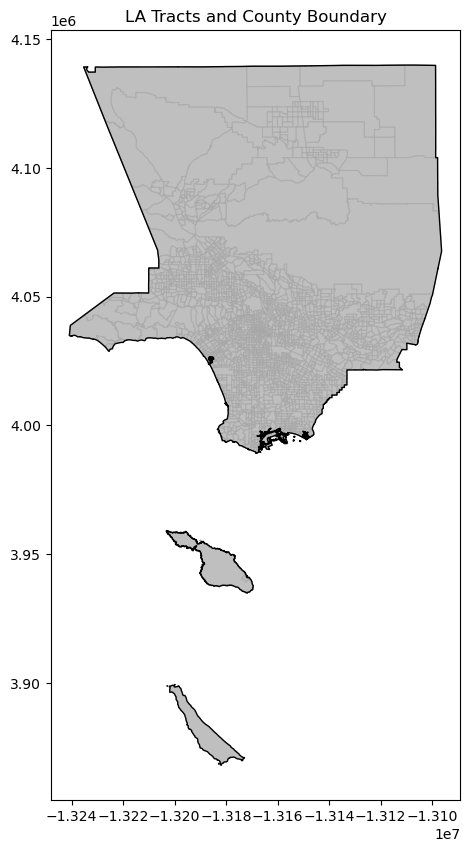

In [36]:
%matplotlib inline
import matplotlib.pyplot as plt 

# Plot la_tracts and clip
fig, ax = plt.subplots(figsize=(10, 10))

# Plot LA tracts with opaque grey fill and dark grey skinny edge color
la_tracts.plot(ax=ax, color='grey', edgecolor='darkgrey', alpha=0.5, linewidth=0.75)

# Plot the clip boundary with black color
clip.boundary.plot(ax=ax, color='black', linewidth=1)

plt.title('LA Tracts and County Boundary')
plt.show()

In [37]:
# Merge the dataframes on GEOID
index_tracts_merge = la_tracts.merge(merged_4index, left_on='GEOID', right_on='GEOID')

# Print the head of the merged dataframe
print(index_tracts_merge.head())

  STATEFP COUNTYFP TRACTCE        GEOID               GEOIDFQ     NAME  \
0      06      037  620102  06037620102  1400000US06037620102  6201.02   
1      06      037  620101  06037620101  1400000US06037620101  6201.01   
2      06      037  620101  06037620101  1400000US06037620101  6201.01   
3      06      037  278102  06037278102  1400000US06037278102  2781.02   
4      06      037  278102  06037278102  1400000US06037278102  2781.02   

               NAMELSAD  MTFCC FUNCSTAT    ALAND   AWATER     INTPTLAT  \
0  Census Tract 6201.02  G5020        S   871913        0  +33.9201935   
1  Census Tract 6201.01  G5020        S  1335926     3064  +33.9274501   
2  Census Tract 6201.01  G5020        S  1335926     3064  +33.9274501   
3  Census Tract 2781.02  G5020        S  1677533  1611460  +33.9583191   
4  Census Tract 2781.02  G5020        S  1677533  1611460  +33.9583191   

       INTPTLON                                           geometry  \
0  -118.4180630  POLYGON ((-13183097.644

In [38]:
index_tracts_merge.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,GEOIDFQ,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,heatrisk_class,City,Tree Canopy Class,RentBurden_class,DistancetoCenter Index
0,06,037,620102,06037620102,1400000US06037620102,6201.02,Census Tract 6201.02,G5020,S,871913,0,+33.9201935,-118.4180630,"POLYGON ((-13183097.644 4018544.687, -13182883...",0,El Segundo,3,0,3
1,06,037,620101,06037620101,1400000US06037620101,6201.01,Census Tract 6201.01,G5020,S,1335926,3064,+33.9274501,-118.4208606,"POLYGON ((-13183392.534 4019531.977, -13183244...",1,El Segundo,4,1,3
2,06,037,620101,06037620101,1400000US06037620101,6201.01,Census Tract 6201.01,G5020,S,1335926,3064,+33.9274501,-118.4208606,"POLYGON ((-13183392.534 4019531.977, -13183244...",1,El Segundo,4,1,3
3,06,037,278102,06037278102,1400000US06037278102,2781.02,Census Tract 2781.02,G5020,S,1677533,1611460,+33.9583191,-118.4523594,"POLYGON ((-13186564.185 4023713.272, -13186543...",0,Playa Del Rey,5,1,2
4,06,037,278102,06037278102,1400000US06037278102,2781.02,Census Tract 2781.02,G5020,S,1677533,1611460,+33.9583191,-118.4523594,"POLYGON ((-13186564.185 4023713.272, -13186543...",0,Playa Del Rey,3,1,2


In [39]:
index_tracts_merge['DistancetoCenter Index']
index_tracts_merge = index_tracts_merge.rename(columns={"DistancetoCenter Index": "Centers_Index"})

In [40]:
# Create the 'tree_heat_index' column
index_tracts_merge['Final_Index'] = (
    index_tracts_merge['heatrisk_class'] + 
    index_tracts_merge['Tree Canopy Class'] +
    index_tracts_merge['RentBurden_class'] +
    index_tracts_merge['Centers_Index']
)
index_tracts_merge.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,GEOIDFQ,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,heatrisk_class,City,Tree Canopy Class,RentBurden_class,Centers_Index,Final_Index
0,06,037,620102,06037620102,1400000US06037620102,6201.02,Census Tract 6201.02,G5020,S,871913,0,+33.9201935,-118.4180630,"POLYGON ((-13183097.644 4018544.687, -13182883...",0,El Segundo,3,0,3,6
1,06,037,620101,06037620101,1400000US06037620101,6201.01,Census Tract 6201.01,G5020,S,1335926,3064,+33.9274501,-118.4208606,"POLYGON ((-13183392.534 4019531.977, -13183244...",1,El Segundo,4,1,3,9
2,06,037,620101,06037620101,1400000US06037620101,6201.01,Census Tract 6201.01,G5020,S,1335926,3064,+33.9274501,-118.4208606,"POLYGON ((-13183392.534 4019531.977, -13183244...",1,El Segundo,4,1,3,9
3,06,037,278102,06037278102,1400000US06037278102,2781.02,Census Tract 2781.02,G5020,S,1677533,1611460,+33.9583191,-118.4523594,"POLYGON ((-13186564.185 4023713.272, -13186543...",0,Playa Del Rey,5,1,2,8
4,06,037,278102,06037278102,1400000US06037278102,2781.02,Census Tract 2781.02,G5020,S,1677533,1611460,+33.9583191,-118.4523594,"POLYGON ((-13186564.185 4023713.272, -13186543...",0,Playa Del Rey,3,1,2,6


In [41]:
top_43_vulnerable = index_tracts_merge.sort_values(by='Final_Index', ascending=False).head(43)
print(top_43_vulnerable)

     STATEFP COUNTYFP TRACTCE        GEOID               GEOIDFQ     NAME  \
2408      06      037  106510  06037106510  1400000US06037106510  1065.10   
1614      06      037  301601  06037301601  1400000US06037301601  3016.01   
1613      06      037  301702  06037301702  1400000US06037301702  3017.02   
2308      06      037  115202  06037115202  1400000US06037115202  1152.02   
2196      06      037  132102  06037132102  1400000US06037132102  1321.02   
2385      06      037  108202  06037108202  1400000US06037108202  1082.02   
2406      06      037  106510  06037106510  1400000US06037106510  1065.10   
2194      06      037  132102  06037132102  1400000US06037132102  1321.02   
1844      06      037  104704  06037104704  1400000US06037104704  1047.04   
2407      06      037  106510  06037106510  1400000US06037106510  1065.10   
1791      06      037  121210  06037121210  1400000US06037121210  1212.10   
1851      06      037  104105  06037104105  1400000US06037104105  1041.05   

# Mapping out the results

In [42]:
# import the themes
import plotly.io as pio

# import the themes
import plotly.io as pio

# for interactive plots 
import plotly.express as px

# list the templates available
pio.templates

Templates configuration
-----------------------
    Default template: 'plotly'
    Available templates:
        ['ggplot2', 'seaborn', 'simple_white', 'plotly',
         'plotly_white', 'plotly_dark', 'presentation', 'xgridoff',
         'ygridoff', 'gridon', 'none']

In [43]:
# set default template to plotly_white
pio.templates.default = "plotly_white"

# Most Vulnerable Census Tracts
## Here we pulled out the census tracts that ranked either a 12 or 13 score on the vulnerablity index
### There are 2 tracts with a 13 score, and 41 tracts with a 12 score
Pacoima, North Hollywood, and Sylmar are the top cities with the most vulnerable tracts 

In [44]:
# bar chart
fig = px.bar(top_43_vulnerable.head(26),
        x='Final_Index',
        y='City',
        title="Most Vulnerable Census Tracts: Heat, Tree, and Rent Burden Index", # title
        text_auto = True,
        height=600,
        width=1000,
        color_discrete_sequence =['#B3DDCC']*len(top_43_vulnerable), # single color for all the bars
        labels={
                'count': 'Number of buildngs',
                'building': 'Type of building',
        })

# bar label
fig.update_traces(textposition='outside',textfont_size=12,textfont_color='#444')

# axes labels
fig.update_yaxes(title_font_size=14,title_font_color='#aaa',tickfont_color='#aaa',tickfont_size=12)
fig.update_xaxes(title_font_size=12,title_font_color='#aaa',tickfont_color='#aaa',tickfont_size=12)

# show the figure
fig.show()

In [45]:
import mapclassify

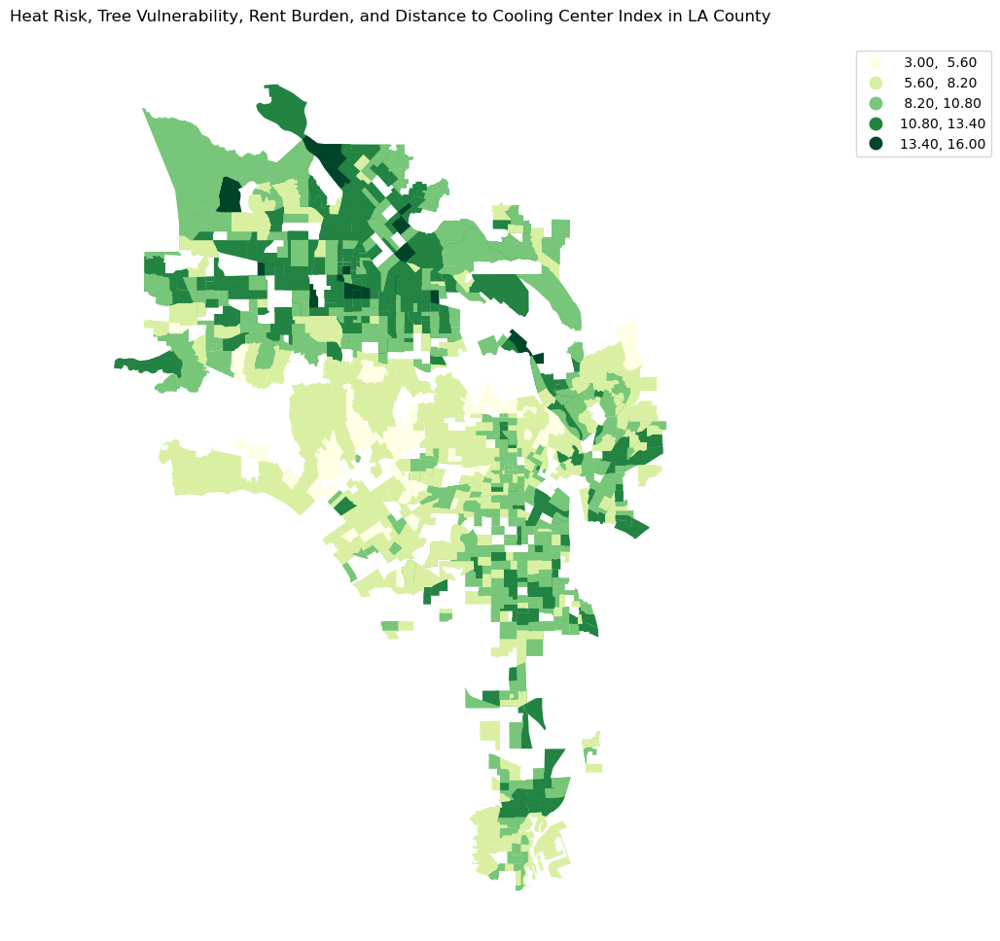

<Figure size 640x480 with 0 Axes>

In [46]:
# Plot the 'housing_transit_index' using equal intervals
fig, ax = plt.subplots(figsize=(10, 10))
index_tracts_merge.plot(column="Final_Index", scheme="Equal_Interval", k=5, cmap="YlGn", linewidth=0, legend=True, ax=ax)

# Use tight layout
plt.tight_layout()
plt.title('Heat Risk, Tree Vulnerability, Rent Burden, and Distance to Cooling Center Index in LA County')
ax.axis('off')

# Place legend outside of plot
ax.get_legend().set_bbox_to_anchor((1.5, 1))
plt.show()

# Save the plot to a PNG file
plt.savefig('cooling_resources_vulnerability_index.png')

In [48]:
import folium
import contextily as ctx
from folium.plugins import HeatMap

# Create a folium map centered around LA County
m = folium.Map(location=[34.0522, -118.2437], zoom_start=8, tiles='cartodbpositron')

# Display the map
folium.Choropleth(
    geo_data=index_tracts_merge,
    name='choropleth',
    data=index_tracts_merge,
    columns=['GEOID', 'Final_Index'],
    key_on='feature.properties.GEOID',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Cooling Resource Vulnerability Index',
    bins=5,  # Set the number of bins for equal interval classification
    reset=True
).add_to(m)

# Save the map as an HTML file
m.save('Cooling Resource Vulnerability.html')

m 

In [49]:
import folium

In [50]:
# import branca library
import branca
import branca.colormap as cm

In [51]:
# create custom color scheme 
colormap = cm.LinearColormap(
    vmin=index_tracts_merge["Final_Index"].quantile(0.0),
    vmax=index_tracts_merge["Final_Index"].quantile(1),
    colors=["#ffffb2", 
            "#fecc5c",
            "#fd8d3c",
            "#f03b20", "#bd0026"],
    caption="Tree, Heat and Rent Burden Vulnerability Index",
)

In [52]:
# using branca and folium documentation to display graduate color map with custom popups 
m2= folium.Map(location=[34.2, -118.2], zoom_start=9, tiles ='CartoDB positron', attribution = 'CartoDB')

#create popup 
popup = folium .GeoJsonPopup(
    fields=["GEOID", "City", "Final_Index"],
    aliases=["GEOID", "City", "Final_Index"],
    localize=True,
    labels=True,
    style="background-color:yellow;",
)

#Create custom tooltip 
tooltip = folium.GeoJsonTooltip(
    fields=["GEOID", "City", "Final_Index"],
    aliases=["GEOID", "City", "Final_Index"],
    localize=True,
    sticky=False,
    Labels=True,
    style="""
    background-color: #F0EFEF;
    border: 2px solid black;
    border-radius:3px;
    box-shadow: 3px;
    """,
    max_width=800,
)

#plot geojson color map with custom line weight 
g2=folium.GeoJson(
    index_tracts_merge,
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["Final_Index"])
        if x["properties"]["Final_Index"] is not None 
        else "transparent", 
        "color": "black",
        "weight": .1,
        "fillOpacity": 0.4,
    },
    tooltip=tooltip,
    popup=popup,
).add_to(m2)

#add color map to variable to map 
colormap.add_to(m2)
m2

In [53]:
# Map of most vulnerable census tracts with heat, tree canopy, rent burden, and farthest distance to cooling center

In [54]:
# using branca and folium documentation to display graduate color map with custom popups 
m2= folium.Map(location=[34.2, -118.2], zoom_start=9, tiles ='CartoDB positron', attribution = 'CartoDB')

#create popup 
popup = folium .GeoJsonPopup(
    fields=["GEOID", "City", "Final_Index"],
    aliases=["GEOID", "City", "Final_Index"],
    localize=True,
    labels=True,
    style="background-color:yellow;",
)

#Create custom tooltip 
tooltip = folium.GeoJsonTooltip(
    fields=["GEOID", "City", "Final_Index"],
    aliases=["GEOID", "City", "Final_Index"],
    localize=True,
    sticky=False,
    Labels=True,
    style="""
    background-color: #F0EFEF;
    border: 2px solid black;
    border-radius:3px;
    box-shadow: 3px;
    """,
    max_width=800,
)

#plot geojson color map with custom line weight 
g2=folium.GeoJson(
    top_43_vulnerable,
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["Final_Index"])
        if x["properties"]["Final_Index"] is not None 
        else "transparent", 
        "color": "black",
        "weight": .1,
        "fillOpacity": 0.4,
    },
    tooltip=tooltip,
    popup=popup,
).add_to(m2)

#add color map to variable to map 
colormap.add_to(m2)
m2